<a href="https://colab.research.google.com/github/Steven412016012/FG_AI_Public/blob/master/Dysgraphic_Pytorch_DCGAN_mod_DNR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Pytorch Begineer Code**

source : https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

### Install

In [1]:
!pip install gdown torch

In [3]:
#meng-unzip dataset tulisan tangan penderita disgraphia
!gdown https://drive.google.com/uc?id=155svuKJN-6Irag5u0Y-sr-TBzFTD5fey

!unzip "/content/DataDys_mod_DNR.zip"

Streaming output truncated to the last 5000 lines.
  inflating: DataDys_mod_DNR/Normal/U-248.png  
  inflating: DataDys_mod_DNR/Normal/U-249.png  
  inflating: DataDys_mod_DNR/Normal/U-25.png  
  inflating: DataDys_mod_DNR/Normal/U-250.png  
  inflating: DataDys_mod_DNR/Normal/U-251.png  
  inflating: DataDys_mod_DNR/Normal/U-252.png  
  inflating: DataDys_mod_DNR/Normal/U-253.png  
  inflating: DataDys_mod_DNR/Normal/U-254.png  
  inflating: DataDys_mod_DNR/Normal/U-255.png  
  inflating: DataDys_mod_DNR/Normal/U-256.png  
  inflating: DataDys_mod_DNR/Normal/U-257.png  
  inflating: DataDys_mod_DNR/Normal/U-258.png  
  inflating: DataDys_mod_DNR/Normal/U-259.png  
  inflating: DataDys_mod_DNR/Normal/U-26.png  
  inflating: DataDys_mod_DNR/Normal/U-260.png  
  inflating: DataDys_mod_DNR/Normal/U-261.png  
  inflating: DataDys_mod_DNR/Normal/U-262.png  
  inflating: DataDys_mod_DNR/Normal/U-263.png  
  inflating: DataDys_mod_DNR/Normal/U-264.png  
  inflating: DataDys_mod_DNR/Normal/U-2

In [4]:
import os
os.listdir('/content/DataDys_mod_DNR') # lihat isi folder test

['Disgraphia', 'Reversal', 'Normal']

###Import & Set Random Seed

In [5]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random

#import library torch (pytorch)
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torchsummary import summary

#import library numpy
import numpy as np

#import library matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


### Input

In [6]:
# Root directory for dataset
dataroot = "/content/DataDys_mod_DNR/"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. 
## All images will be resized to this size using a transformer 
### (default image size = 64).
image_size = 64

# Number of channels in the training images. 
## For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

### Load Dataset

In [12]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Decide which device we want to run on
device

device(type='cuda', index=0)

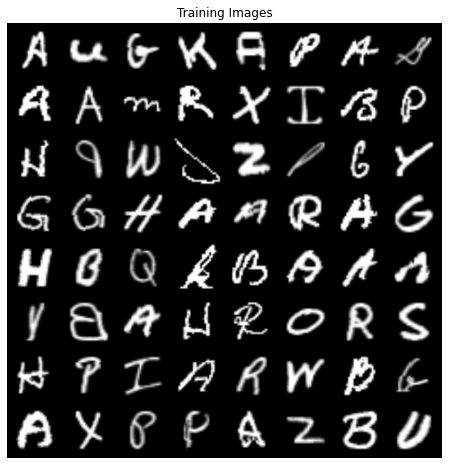

In [29]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size), 
                               transforms.CenterCrop(image_size), 
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")

#menampilkan berapa dataset
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

**Explorasi Data**

In [30]:
trainimages, trainlabels = next(iter(dataloader))

#untuk mengetahui shape sizenya
trainimages.shape

torch.Size([128, 3, 64, 64])

In [31]:
len(trainimages)

128

In [32]:
len(trainlabels)

128

**Struktur data**

*   128 = jumlah label dan gambar
*   C = 3 = jumlah channel adalah 3
*   H = 64 = panjang gambar 54 px
*   W = 64 = lebar gambar 64 px

**Implementation**


### Weight Initialization

In [33]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### Generator

Summary

Number of GPUs available. Use 0 for CPU mode

```
# ngpu = 1
```

Size of z latent vector (i.e. size of generator input)
```
# nz = 100
```

Size of feature maps in generator
```
# ngf = 64
```


Number of channels in the training images. For color images this is 3
```
# nc = 3
```




In [34]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # ======== input is Z, going into a convolution  ======== #
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [35]:
summary(netG, (100,64,64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1          [-1, 512, 67, 67]         819,200
       BatchNorm2d-2          [-1, 512, 67, 67]           1,024
              ReLU-3          [-1, 512, 67, 67]               0
   ConvTranspose2d-4        [-1, 256, 134, 134]       2,097,152
       BatchNorm2d-5        [-1, 256, 134, 134]             512
              ReLU-6        [-1, 256, 134, 134]               0
   ConvTranspose2d-7        [-1, 128, 268, 268]         524,288
       BatchNorm2d-8        [-1, 128, 268, 268]             256
              ReLU-9        [-1, 128, 268, 268]               0
  ConvTranspose2d-10         [-1, 64, 536, 536]         131,072
      BatchNorm2d-11         [-1, 64, 536, 536]             128
             ReLU-12         [-1, 64, 536, 536]               0
  ConvTranspose2d-13        [-1, 3, 1072, 1072]           3,072
             Tanh-14        [-1, 3, 107

### Discriminator

In [36]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [37]:
summary(netD, (3,64,64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,072
         LeakyReLU-2           [-1, 64, 32, 32]               0
            Conv2d-3          [-1, 128, 16, 16]         131,072
       BatchNorm2d-4          [-1, 128, 16, 16]             256
         LeakyReLU-5          [-1, 128, 16, 16]               0
            Conv2d-6            [-1, 256, 8, 8]         524,288
       BatchNorm2d-7            [-1, 256, 8, 8]             512
         LeakyReLU-8            [-1, 256, 8, 8]               0
            Conv2d-9            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-10            [-1, 512, 4, 4]           1,024
        LeakyReLU-11            [-1, 512, 4, 4]               0
           Conv2d-12              [-1, 1, 1, 1]           8,192
          Sigmoid-13              [-1, 1, 1, 1]               0
Total params: 2,765,568
Trainable param

### Loss Functions and Optimizers

In [38]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
# the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

### Training

In [39]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        #=====================================================================#
        #     (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))     #
        #=====================================================================#
        
        ## ========== Train with all-real batch ========== 
        netD.zero_grad()

        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, 
                           dtype=torch.float, device=device)
        
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)

        # Calculate loss on all-real batch
        errD_real = criterion(output, label)

        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## ========== Train with all-fake batch ========== 

        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)

        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)

        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)

        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)

        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake

        # Update D
        optimizerD.step()

        #===================================================================#
        #           (2) Update G network: maximize log(D(G(z)))             #
        #===================================================================#
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost

        # Since we just updated D, 
        # perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)

        # Calculate G's loss based on this output
        errG = criterion(output, label)

        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 100 == 0: #training load data
            print('epoch: [%d/%d] | dataloader: [%d/%d] | Loss_D: %.4f | Loss_G: %.4f | D(x): %.4f | D(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
epoch: [0/100] | dataloader: [0/260] | Loss_D: 1.8114 | Loss_G: 4.4656 | D(x): 0.5806 | D(G(z)): 0.6195 / 0.0189
epoch: [0/100] | dataloader: [100/260] | Loss_D: 0.3463 | Loss_G: 18.1639 | D(x): 0.7909 | D(G(z)): 0.0000 / 0.0000
epoch: [0/100] | dataloader: [200/260] | Loss_D: 0.1001 | Loss_G: 4.0812 | D(x): 0.9667 | D(G(z)): 0.0618 / 0.0215
epoch: [1/100] | dataloader: [0/260] | Loss_D: 0.1621 | Loss_G: 3.8516 | D(x): 0.9088 | D(G(z)): 0.0530 / 0.0301
epoch: [1/100] | dataloader: [100/260] | Loss_D: 0.2664 | Loss_G: 1.9038 | D(x): 0.8518 | D(G(z)): 0.0783 / 0.1856
epoch: [1/100] | dataloader: [200/260] | Loss_D: 0.2497 | Loss_G: 4.1995 | D(x): 0.9172 | D(G(z)): 0.1353 / 0.0223
epoch: [2/100] | dataloader: [0/260] | Loss_D: 1.3432 | Loss_G: 0.7179 | D(x): 0.3466 | D(G(z)): 0.0247 / 0.5239
epoch: [2/100] | dataloader: [100/260] | Loss_D: 0.3159 | Loss_G: 2.1345 | D(x): 0.8395 | D(G(z)): 0.1078 / 0.1523
epoch: [2/100] | dataloader: [200/260] | Loss_D: 0.7773 | L

### Result

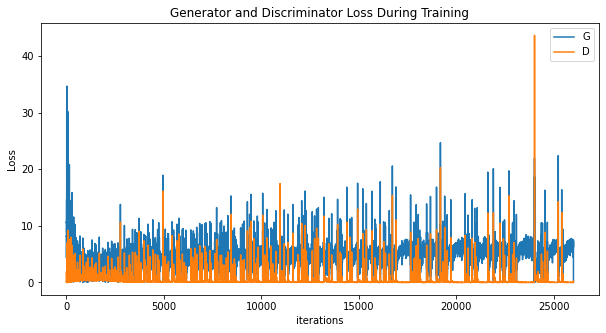

In [40]:
#Loss versus training iteration

plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21056550 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


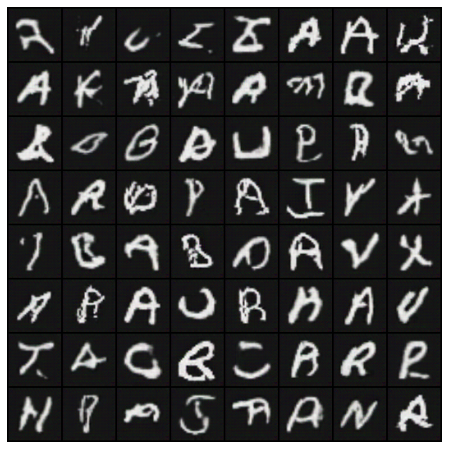

In [41]:
#Visualization of G’s progression

#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

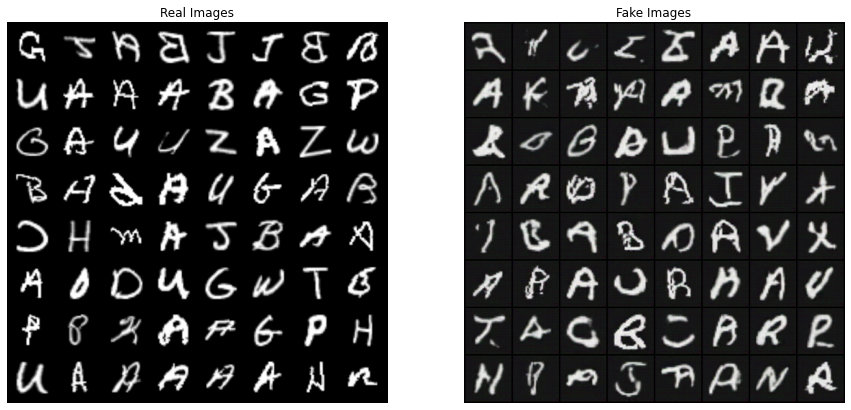

In [42]:
#Real Images vs. Fake Images

# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()